# Title: Comparison and Exploratory data analysis of SAM2 generated feature extraction data for Faba beans
Author: Harpreet Kaur Bargota
Email: harpreet.bargota@agr.gc.ca
Date: June 17, 2025

In [1]:
#import the libraries required for analysis
import pandas as pd
import seaborn as sns
import cv2
import os
import matplotlib.pyplot as plt
from scipy.stats import (pearsonr, ttest_rel, f_oneway, spearmanr, shapiro, levene, wilcoxon, kruskal, skew, kurtosis )
import warnings
warnings.filterwarnings(action='ignore')

## Read the .csv files of feature extraction for SAM and SAM2.1

In [2]:
#read the .csv files
SegAny2_1=pd.read_csv(r"output_FE_SAM2.1\FE_Color.csv")
print ("SAM2.1 ....")


SAM2.1 ....


In [3]:
# check shape of df
print ("Shape: ", SegAny2_1.shape)

# check info
print ("Dataset information: ", SegAny2_1.info())

# check the index
print ("Datastet index: ", SegAny2_1.index)

# check the missing values
print ("Missing values: ", SegAny2_1.isnull().sum())

Shape:  (4234, 32)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4234 entries, 0 to 4233
Data columns (total 32 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Seed No. per image          4234 non-null   int64  
 1   Class                       4234 non-null   object 
 2   Area-SAM(mm2)               4234 non-null   float64
 3   Length-SAM(mm)              4234 non-null   float64
 4   Width-SAM(mm)               4234 non-null   float64
 5   Perimeter-SAM(mm)           4234 non-null   float64
 6   centroid-0                  4234 non-null   float64
 7   centroid-1                  4234 non-null   float64
 8   bbox-0                      4234 non-null   int64  
 9   bbox-1                      4234 non-null   int64  
 10  bbox-2                      4234 non-null   int64  
 11  bbox-3                      4234 non-null   int64  
 12  Area-SAM(pix)               4234 non-null   float64
 13  Eccentricity  

In [4]:
# Create a copy of original df
SAM=SegAny2_1.copy()

In [5]:
SAM = SAM[SAM["Area-SAM(pix)"] != 24]

### Create a new column with the image code from the Class

In [6]:
SAM['ID']=SAM['Class'].str.split('_').str[-1]
SAM.head(2)

,Seed No. per image,Class,Area-SAM(mm2),Length-SAM(mm),Width-SAM(mm),Perimeter-SAM(mm),centroid-0,centroid-1,bbox-0,bbox-1,...,Compactness,Circularity-SAM,Shape,Shapefactor1,Shapefactor2,Shapefactor3,Shapefactor4,RGB value of Seed,color_seeds,ID
0,0,Faba-Seed-CC_Vf447-1-1,95.998881,11.248159,10.770226,34.592780,2335.508590,2079.002664,2171,1955,...,0.882754,1.155145,"Elongated,Oval,Elongated,Ellipse",0.005105,0.004002,0.779651,0.994664,"(163, 158, 120)",tan,Vf447-1-1
1,1,Faba-Seed-CC_Vf447-1-1,90.066237,10.808319,10.496649,33.274504,2385.548399,1416.398551,2266,1260,...,0.889838,1.139182,"Elongated,Oval,Elongated,Ellipse",0.005229,0.004157,0.792214,0.996483,"(165, 165, 129)",tan,Vf447-1-1


In [7]:
SAM.columns

Index(['Seed No. per image', 'Class', 'Area-SAM(mm2)', 'Length-SAM(mm)',
       'Width-SAM(mm)', 'Perimeter-SAM(mm)', 'centroid-0', 'centroid-1',
       'bbox-0', 'bbox-1', 'bbox-2', 'bbox-3', 'Area-SAM(pix)', 'Eccentricity',
       'Equivalent diameter area', 'Perimeter (pix)', 'Solidity',
       'Area convex', 'Extent', 'Axis Major Length-SAM(pix)',
       'Axis Minor Length-SAM(pix)', 'Aspect Ratio', 'Roundness',
       'Compactness', 'Circularity-SAM', 'Shape', 'Shapefactor1',
       'Shapefactor2', 'Shapefactor3', 'Shapefactor4', 'RGB value of Seed',
       'color_seeds', 'ID'],
      dtype='object')

## Exploratory Data Analysis for SAM2.1-generated Feature extraction data

1. Exploratory_data_analysis(df):
DataFrame Head: Displays the first five rows of the DataFrame, giving a quick snapshot of the data.
DataFrame Info: Provides information about the DataFrame, including the number of entries, column names, data types, and the number of non-null values in each column.
DataFrame Description: Shows summary statistics for numerical columns, such as count, mean, standard deviation, minimum, 25th percentile, median (50th percentile), 75th percentile, and maximum values.
Missing Values: Lists the number of missing values in each column, helping you identify columns that may need data cleaning.

2. Target Counts-check_balance(df): 
Displays the count of each class in the target variable, helping to understand the distribution of classes.
Class Distribution Bar Plot: Visualizes the class distribution with a bar plot, making it easy to see if any class is underrepresented.
Balance Check: Determines if the dataset is balanced or unbalanced. If the smallest class count is less than half of the largest class count, it will indicate that the dataset is unbalanced.

3. Correlation Matrix Heatmap-heatmap(df): 
Visualizes the correlation between features using a heatmap. The heatmap will show the strength and direction of relationships between features, with values ranging from -1 to 1. Strong positive correlations will be close to 1, strong negative correlations will be close to -1, and weak or no correlations will be close to 0.

4. Kernel Density Plots-kdplot(df): 

Plots the distribution of numerical features with a kernel density estimate (KDE). Each plot will show the distribution of a feature, including its skewness. This helps to understand the shape of the data distribution and identify any potential outliers or skewed distributions.

5. Extreme Values DataFrame-extremes_df(df): 
Creates a DataFrame that lists the minimum and maximum values for each feature, along with the corresponding class (index). This helps to identify the range of values for each feature and the classes that have extreme values.

6. Pairwise Scatter Plots-pairplot(df): 
Generates scatter plots for all pairs of features. This helps to visualize relationships between features and identify any patterns or correlations. It also includes histograms on the diagonal to show the distribution of each feature.

In [8]:
# Exploratory Data Analysis (EDA)
def exploratory_data_analysis(df):
    print("DataFrame Head:\n", df.head(2))
    print("\n\n")
    print("DataFrame Info: ")
    df.info()
    print("\nDataFrame Description:\n", df.describe())
    print("\nMissing Values:\n", df.isnull().sum())
    print("\n\n")
    
    
# Check for balanced/unbalanced dataset
def check_balance(df):
    target_counts = df.index.value_counts()
    print("\nTarget Counts:\n", target_counts)
    sns.barplot(x=target_counts.index, y=target_counts.values)
    plt.title('Class Distribution')
    plt.show()
    
    if len(target_counts) > 1 and min(target_counts) / max(target_counts) < 0.5:
        print("Dataset is unbalanced.")
        return False
    else:
        print("Dataset is balanced.")
        print("\n\n")
        return True

# heatmap   
def heatmap(df):
    print("\n\n")
    plt.figure(figsize=(18, 12))
    sns.heatmap(df.corr(), annot=True, cmap='viridis')
    plt.title('Feature Correlation Matrix')
    plt.show()
    print("\n\n")

# Kernel density plot
def kdplot(df):
    sns.set_style("darkgrid")
    numerical_columns = NUM.select_dtypes(include=["int64", "float64"]).columns
    plt.figure(figsize=(14, len(numerical_columns) * 3))
    for idx, feature in enumerate(numerical_columns, 1):
        plt.subplot(len(numerical_columns), 4, idx)
        sns.histplot(NUM[feature], kde=True)
        plt.title(f"{feature} | Skewness: {round(NUM[feature].skew(), 2)}")
    plt.tight_layout()
    plt.show()
    print("\n\n")

# Extreme values
def extremes_df(df):
    # Find class (index) with min and max for each column
    min_ids = df.idxmin()
    max_ids = df.idxmax()

    # Get the corresponding min and max values
    min_values = df.min()
    max_values = df.max()

    # Combine into a DataFrame for easy viewing
    extremes_df = pd.DataFrame({
    'Feature': df.columns,
    'Min_Class': min_ids.values,
    'Min_Value': min_values.values,
    'Max_Class': max_ids.values,
    'Max_Value': max_values.values
    })
    print(extremes_df)
    print("\n\n")

# Pair plot
def pairplot(df):
    sns.pairplot(df)
    plt.show()
    print("\n\n")


## Data for each seed from images - dataframe 'NUM'

In [9]:
NUM=SAM[['Area-SAM(mm2)', 'Length-SAM(mm)', 'Width-SAM(mm)', 'Perimeter-SAM(mm)',
'Area-SAM(pix)', 'Eccentricity', 'Equivalent diameter area', 'Perimeter (pix)',
'Solidity', 'Area convex', 'Extent', 'Axis Major Length-SAM(pix)',
'Axis Minor Length-SAM(pix)', 'Aspect Ratio', 'Roundness', 'Compactness',
'Circularity-SAM', 'Shapefactor1', 'Shapefactor2', 'Shapefactor3',
'Shapefactor4', 'ID']]
NUM=NUM.set_index('ID')

During the seed count analysis, a non-specific circular object on the background sheet was mistakenly identified as a bean. To ensure accurate results, the data for the object was removed before proceeding with the analysis.

In [10]:
NUM.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4233 entries, Vf447-1-1 to Vf299-3-1
Data columns (total 21 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Area-SAM(mm2)               4233 non-null   float64
 1   Length-SAM(mm)              4233 non-null   float64
 2   Width-SAM(mm)               4233 non-null   float64
 3   Perimeter-SAM(mm)           4233 non-null   float64
 4   Area-SAM(pix)               4233 non-null   float64
 5   Eccentricity                4233 non-null   float64
 6   Equivalent diameter area    4233 non-null   float64
 7   Perimeter (pix)             4233 non-null   float64
 8   Solidity                    4233 non-null   float64
 9   Area convex                 4233 non-null   float64
 10  Extent                      4233 non-null   float64
 11  Axis Major Length-SAM(pix)  4233 non-null   float64
 12  Axis Minor Length-SAM(pix)  4233 non-null   float64
 13  Aspect Ratio             

DataFrame Head:
            Area-SAM(mm2)  Length-SAM(mm)  Width-SAM(mm)  Perimeter-SAM(mm)  \
ID                                                                           
Vf447-1-1      95.998881       11.248159      10.770226          34.592780   
Vf447-1-1      90.066237       10.808319      10.496649          33.274504   

           Area-SAM(pix)  Eccentricity  Equivalent diameter area  \
ID                                                                 
Vf447-1-1        62687.0      0.620971                282.516490   
Vf447-1-1        58813.0      0.606596                273.647652   

           Perimeter (pix)  Solidity  Area convex  ...  \
ID                                                 ...   
Vf447-1-1       953.678282  0.993896      63072.0  ...   
Vf447-1-1       917.335137  0.994067      59164.0  ...   

           Axis Major Length-SAM(pix)  Axis Minor Length-SAM(pix)  \
ID                                                                  
Vf447-1-1                 

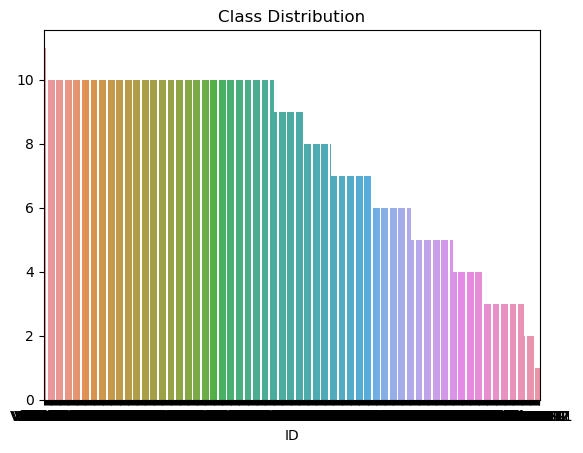

Dataset is unbalanced.





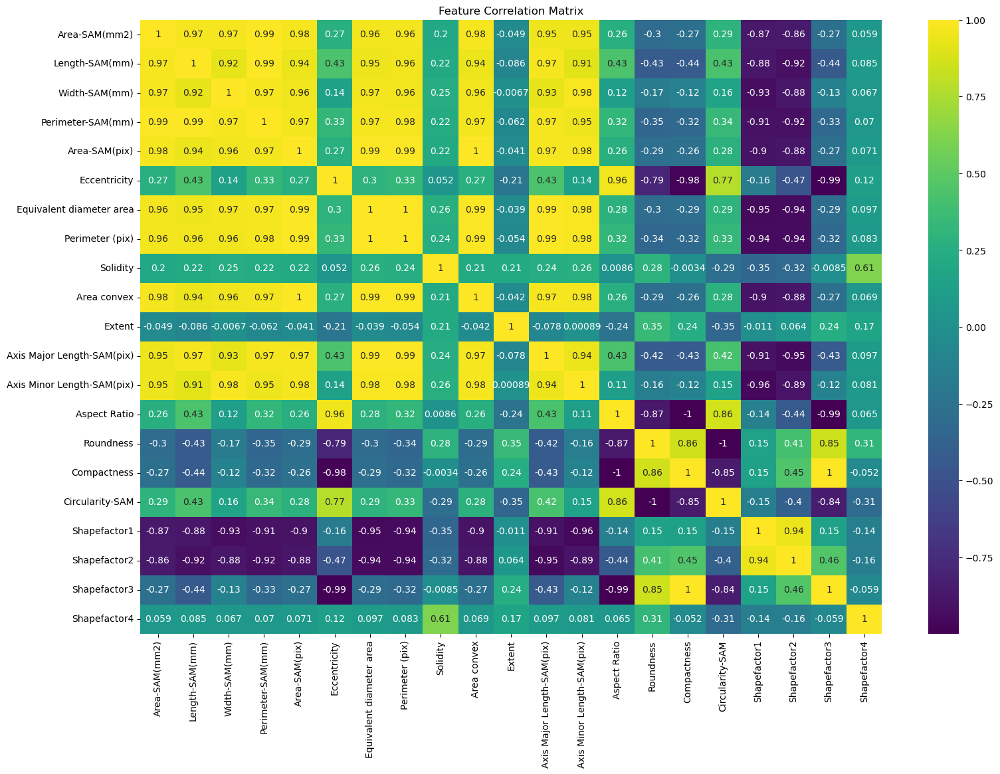

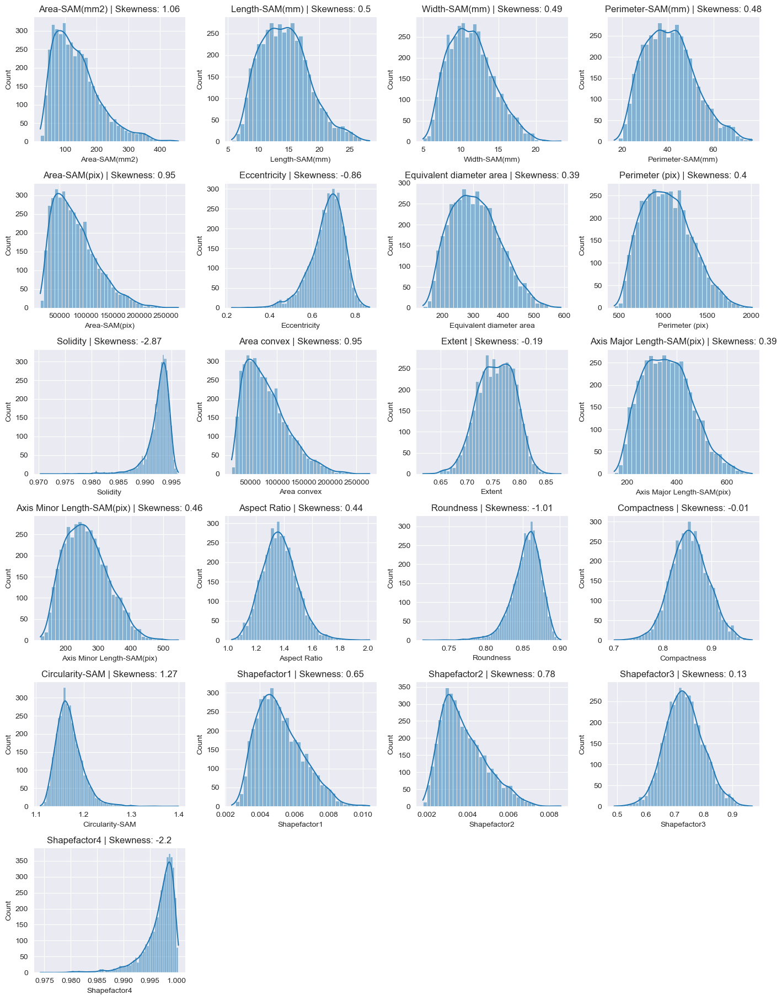




                       Feature  Min_Class     Min_Value  Max_Class  \
0                Area-SAM(mm2)   Vf90-1-1     21.907123  Vf342-3-1   
1               Length-SAM(mm)   Vf90-1-1      5.637685  Vf413-3-1   
2                Width-SAM(mm)   Vf90-1-1      4.948434   Vf46-1-1   
3            Perimeter-SAM(mm)   Vf90-1-1     16.572178  Vf413-3-1   
4                Area-SAM(pix)   Vf90-1-1  14291.000000  Vf260-1-1   
5                 Eccentricity  Vf589-3-1      0.222974  Vf243-1-1   
6     Equivalent diameter area   Vf90-1-1    134.892054  Vf260-1-1   
7              Perimeter (pix)   Vf90-1-1    448.315801  Vf260-1-1   
8                     Solidity  Vf139-1-1      0.970337  Vf293-1-2   
9                  Area convex   Vf90-1-1  14439.000000  Vf260-1-1   
10                      Extent  Vf455-1-1      0.616351  Vf613-1-1   
11  Axis Major Length-SAM(pix)   Vf90-1-1    148.659235  Vf260-1-1   
12  Axis Minor Length-SAM(pix)   Vf90-1-1    122.631129   Vf46-1-1   
13               

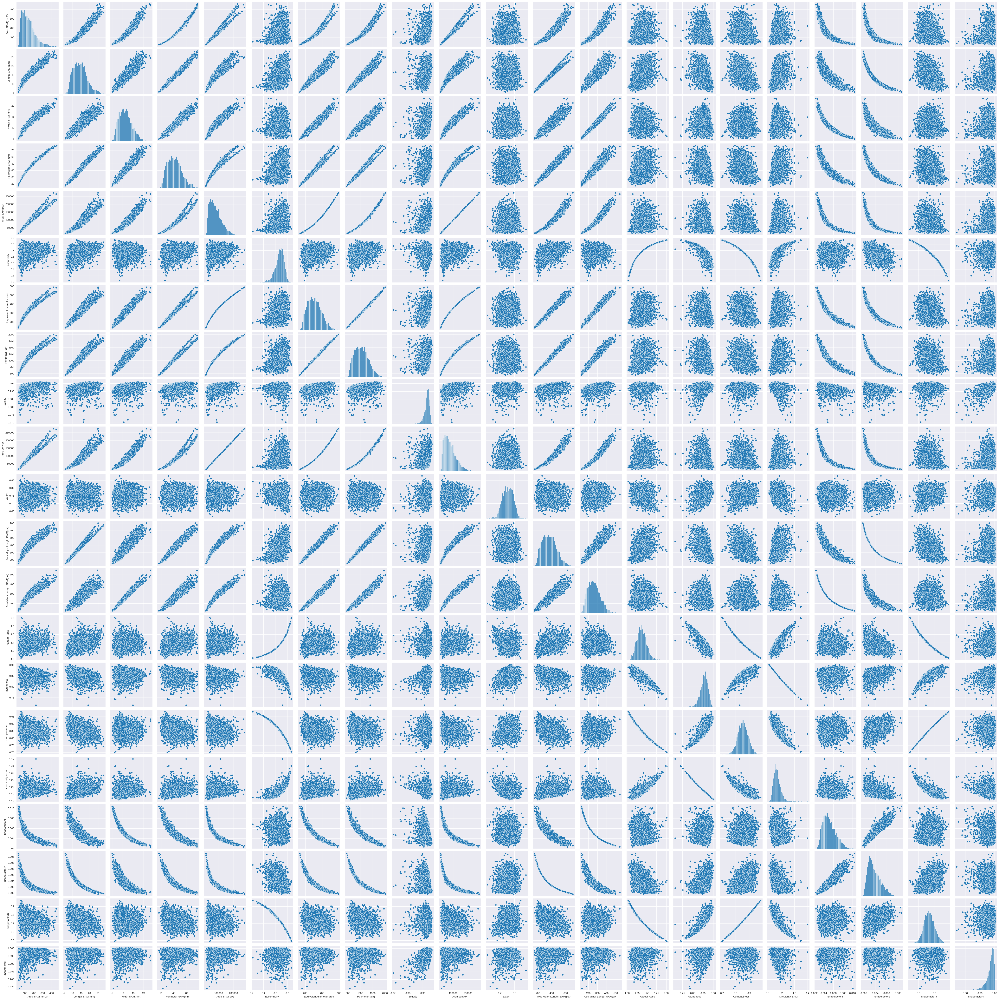

In [11]:
# Exploratory Data Analysis (EDA)
exploratory_data_analysis(NUM)
check_balance(NUM)
heatmap(NUM)
kdplot(NUM)
extremes_df(NUM)
pairplot(NUM)

### Result:
The dataset consists of 4233 entries with 21 columns, all of which are of the float64 data type, indicating that they contain numerical data. The memory usage of the DataFrame is approximately 727.7 KB.

The descriptive statistics provide insights into the distribution of the numerical features. For instance, the Area_mm2_SAM column has a mean value of 137.03, a standard deviation of 72.71, and ranges from a minimum of 0.04 to a maximum of 457.54. Similarly, other columns such as Length_mm_SAM, Width_mm_SAM, and perimeter_mm_SAM show their respective statistical summaries, highlighting the central tendency and variability within the data.

The missing values analysis reveals that there are no missing values in any of the columns, ensuring the completeness of the dataset.

The analysis of the datasets reveals several strong positive correlations (0.9-1) between key morphological features of the seeds. Specifically, a strong positive correlation was observed among Area_mm2_SAM, Length_mm_SAM, Width_mm_SAM, perimeter_mm_SAM, Area_pix_SAM, equivalent_diameter_area, perimeter, area_convex, Axis Major Length(pix)_SAM, and Axis Minor Length(pix)_SAM. This indicates that as one of these variables increases, the others also tend to increase. For example, seeds with larger areas are likely to have greater lengths, widths, and perimeters, as well as larger equivalent diameters, convex areas, and axis lengths. These positive correlations suggest that these morphological features are interrelated and tend to scale together, reflecting the overall size and shape of the seeds.
Additionally, a strong positive correlation was observed between eccentricity and aspect ratio, indicating that seeds with higher eccentricity (more elongated) also tend to have higher aspect ratios. This suggests that these two features are closely related in describing the elongation of the seeds. Similarly, compactness and shapefactor3 show a strong positive correlation, suggesting that seeds with higher compactness values (more dense and solid) also tend to have higher shapefactor3 values. This indicates that these features are related in describing the density and solidity of the seeds. Lastly, a strong positive correlation between shapefactor2 and shapefactor1 indicates that seeds with higher shapefactor2 values also tend to have higher shapefactor1 values. This suggests that these shape factors are interrelated and describe similar aspects of seed morphology.
Strong negative correlation was observed between compactness and eccentricity, indicating that as the compactness of the seeds increases, their eccentricity decreases. This suggests that more compact seeds are less elongated. Similarly, the strong negative correlation between eccentricity and shapefactor3 implies that seeds with higher eccentricity values tend to have lower shapefactor3 values, indicating that more elongated seeds have less dense shapes. Lastly, the negative correlation between aspect ratio and shapefactor3 suggests that seeds with higher aspect ratios (more elongated) tend to have lower shapefactor3 values, indicating a less dense shape. 

The kernel density plots provided valuable insights into the distribution and skewness of numerical features in the dataset. These visualizations helped identify patterns, anomalies, and the overall structure of the data, which were crucial for further analysis and modeling.

The target counts indicate the distribution of different classes within the dataset. The counts range from 1 to 11, with a total of 554 unique classes. This distribution is visualized using a bar plot, which helps in understanding the class balance. The dataset appears to be unbalanced, as some classes have significantly fewer entries compared to others.

Size of seeds:
The comparison of seed size and shape across different classes reveals significant variability. The smallest seed area was observed in class Vf90-1-1 with a value of 21.91 mm², while the largest area was found in class Vf342-3-1, measuring 457.54 mm². Similarly, the length of seeds ranged from 5.64 mm in class Vf90-1-1 to 28.26 mm in class Vf413-3-1. Width measurements varied from 4.95 mm in class Vf90-1-1 to 23.36 mm in class Vf46-1-1. Perimeter values also showed considerable differences, with the smallest perimeter being 16.57 mm in class Vf90-1-1 and the largest being 76.97 mm in class Vf413-3-1. 

Shape of seeds:
Features such as eccentricity, equivalent diameter, solidity, and various shape factors further highlight the diversity in seed morphology, indicating that different classes exhibit distinct physical characteristics. For instance, the eccentricity values range from 0.22 in class Vf589-3-1 to 0.87 in class Vf243-1-1, indicating differences in how elongated or circular the beans are. Similarly, the aspect ratio varies from 1.03 in class Vf589-3-1 to 2.01 in class Vf243-1-1, suggesting variations in the length-to-width ratio of the beans. Roundness and compactness also show notable differences, with roundness values ranging from 0.71 in class Vf224-3-2 to 0.90 in class Vf603-1-1, and compactness values ranging from 0.70 in class Vf243-1-1 to 0.98 in class Vf589-3-1. These metrics indicate how closely the shape of the beans approaches a perfect circle and how dense or solid they appear.The shape of beans varies significantly across different classes, as evidenced by the diverse measurements of features such as eccentricity, aspect ratio, roundness, compactness, and various shape factors.

The pairplot analysis provided valuable insights into the relationships and distributions of numerical features within the dataset. The scatter plots revealed various patterns and trends, including clusters and correlations between features. For instance, strong positive correlations were observed between certain pairs of features, indicating a close relationship. The histograms on the diagonal plots illustrated the distribution of each feature, highlighting differences in spread and skewness

In [12]:
NUM.columns

Index(['Area-SAM(mm2)', 'Length-SAM(mm)', 'Width-SAM(mm)', 'Perimeter-SAM(mm)',
       'Area-SAM(pix)', 'Eccentricity', 'Equivalent diameter area',
       'Perimeter (pix)', 'Solidity', 'Area convex', 'Extent',
       'Axis Major Length-SAM(pix)', 'Axis Minor Length-SAM(pix)',
       'Aspect Ratio', 'Roundness', 'Compactness', 'Circularity-SAM',
       'Shapefactor1', 'Shapefactor2', 'Shapefactor3', 'Shapefactor4'],
      dtype='object')

## Average seed data per bean line is in dataframe - 'avg_df'

In [13]:

# Columns of interest

cols=['Area-SAM(mm2)', 'Length-SAM(mm)', 'Width-SAM(mm)', 'Perimeter-SAM(mm)',
       'Area-SAM(pix)', 'Eccentricity', 'Equivalent diameter area',
       'Perimeter (pix)', 'Solidity', 'Area convex', 'Extent',
       'Axis Major Length-SAM(pix)', 'Axis Minor Length-SAM(pix)',
       'Aspect Ratio', 'Roundness', 'Compactness', 'Circularity-SAM',
      'Shapefactor1', 'Shapefactor2', 'Shapefactor3', 'Shapefactor4']


# Group by class and calculate mean
avg_df = SAM.groupby('ID')[cols].mean().reset_index()

# Rename columns to include "Avg_"
avg_df = avg_df.rename(columns={col: f'Avg_{col.split("_SAM")[0] if "_SAM" in col else col}' for col in cols})

# set the column "ID" as index
avg_df=avg_df.set_index('ID')

# Display the resulting DataFrame
avg_df.head(2)

,Avg_Area-SAM(mm2),Avg_Length-SAM(mm),Avg_Width-SAM(mm),Avg_Perimeter-SAM(mm),Avg_Area-SAM(pix),Avg_Eccentricity,Avg_Equivalent diameter area,Avg_Perimeter (pix),Avg_Solidity,Avg_Area convex,...,Avg_Axis Major Length-SAM(pix),Avg_Axis Minor Length-SAM(pix),Avg_Aspect Ratio,Avg_Roundness,Avg_Compactness,Avg_Circularity-SAM,Avg_Shapefactor1,Avg_Shapefactor2,Avg_Shapefactor3,Avg_Shapefactor4
ID,,,,,,,,,,,,,,,,,,,,,
Vf1-1-2,224.506175,19.723124,14.492135,54.364649,137819.75,0.703585,418.409906,1423.790547,0.994763,138541.0,...,497.471554,352.863993,1.409362,0.852206,0.841535,1.173540,0.003624,0.002574,0.708680,0.998009
Vf100-1-2,142.275543,14.436554,12.517163,42.897984,72966.60,0.579467,303.376140,1025.809061,0.990280,73651.1,...,339.363640,272.959419,1.239627,0.862771,0.896944,1.159214,0.004714,0.003829,0.805669,0.994924


DataFrame Head:
            Avg_Area-SAM(mm2)  Avg_Length-SAM(mm)  Avg_Width-SAM(mm)  \
ID                                                                    
Vf1-1-2           224.506175           19.723124          14.492135   
Vf100-1-2         142.275543           14.436554          12.517163   

           Avg_Perimeter-SAM(mm)  Avg_Area-SAM(pix)  Avg_Eccentricity  \
ID                                                                      
Vf1-1-2                54.364649          137819.75          0.703585   
Vf100-1-2              42.897984           72966.60          0.579467   

           Avg_Equivalent diameter area  Avg_Perimeter (pix)  Avg_Solidity  \
ID                                                                           
Vf1-1-2                      418.409906          1423.790547      0.994763   
Vf100-1-2                    303.376140          1025.809061      0.990280   

           Avg_Area convex  ...  Avg_Axis Major Length-SAM(pix)  \
ID                       

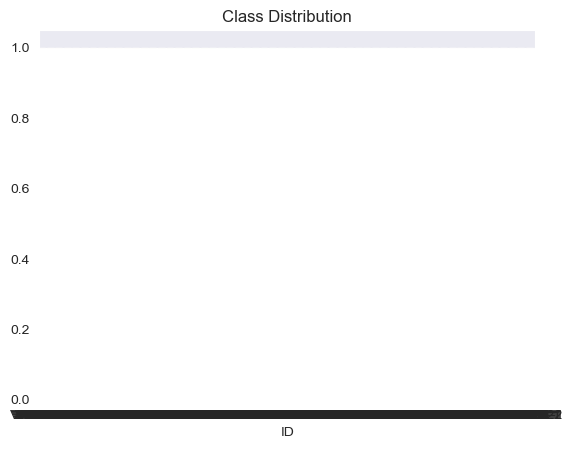

Dataset is balanced.








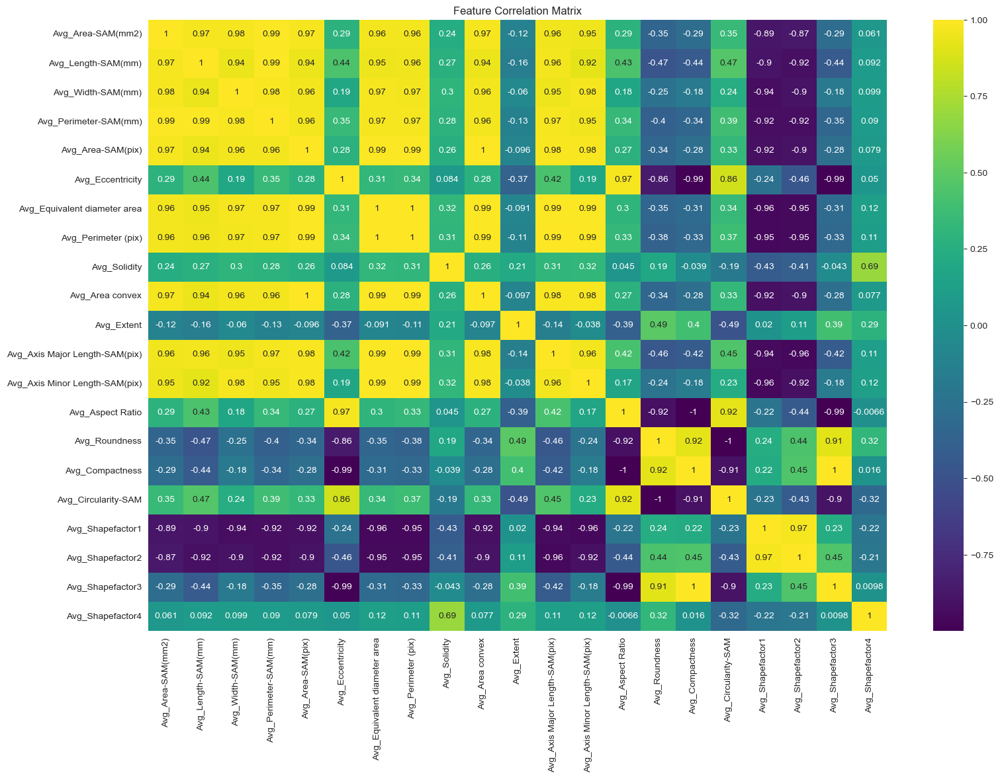

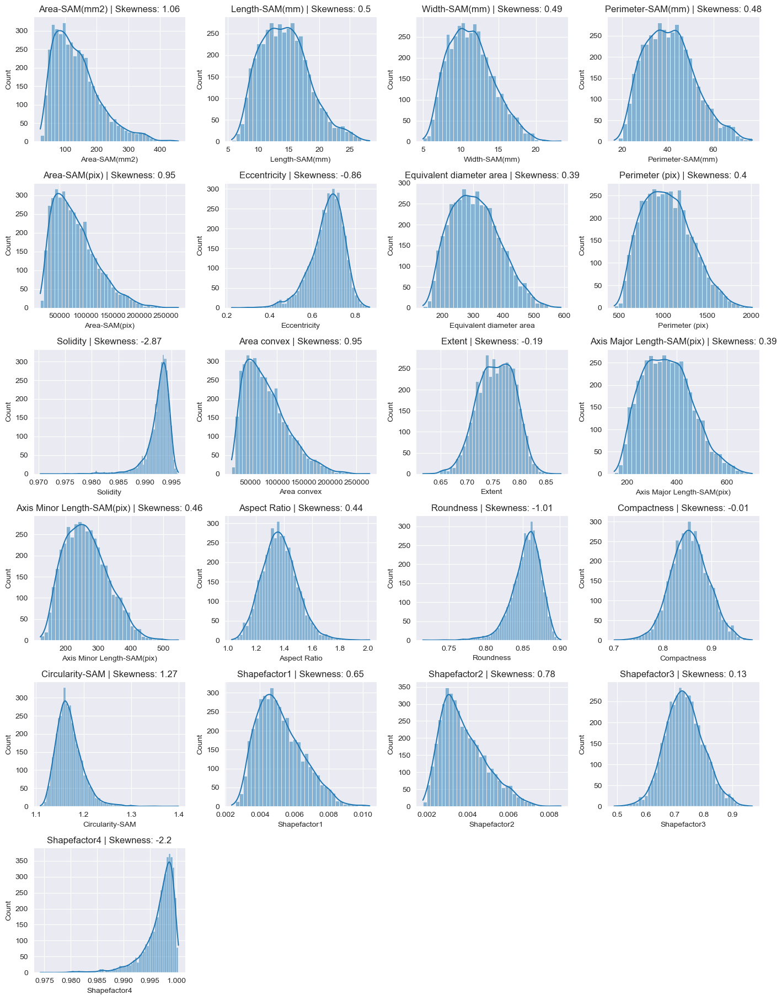




                           Feature  Min_Class     Min_Value  Max_Class  \
0                Avg_Area-SAM(mm2)   Vf62-1-1     29.569200  Vf342-3-1   
1               Avg_Length-SAM(mm)   Vf94-1-2      6.995364  Vf335-3-1   
2                Avg_Width-SAM(mm)   Vf62-1-1      5.283249  Vf342-3-1   
3            Avg_Perimeter-SAM(mm)  Vf117-1-2     20.066824  Vf342-3-1   
4                Avg_Area-SAM(pix)   Vf62-1-1  17540.000000   Vf72-1-1   
5                 Avg_Eccentricity  Vf589-3-1      0.454748  Vf547-3-2   
6     Avg_Equivalent diameter area   Vf62-1-1    149.441031  Vf342-3-1   
7              Avg_Perimeter (pix)   Vf62-1-1    521.286363   Vf72-1-1   
8                     Avg_Solidity   Vf62-1-1      0.983294  Vf183-1-2   
9                  Avg_Area convex   Vf62-1-1  17838.000000   Vf72-1-1   
10                      Avg_Extent  Vf329-3-1      0.698467  Vf578-2-1   
11  Avg_Axis Major Length-SAM(pix)   Vf62-1-1    181.955129  Vf335-3-1   
12  Avg_Axis Minor Length-SAM(pix) 

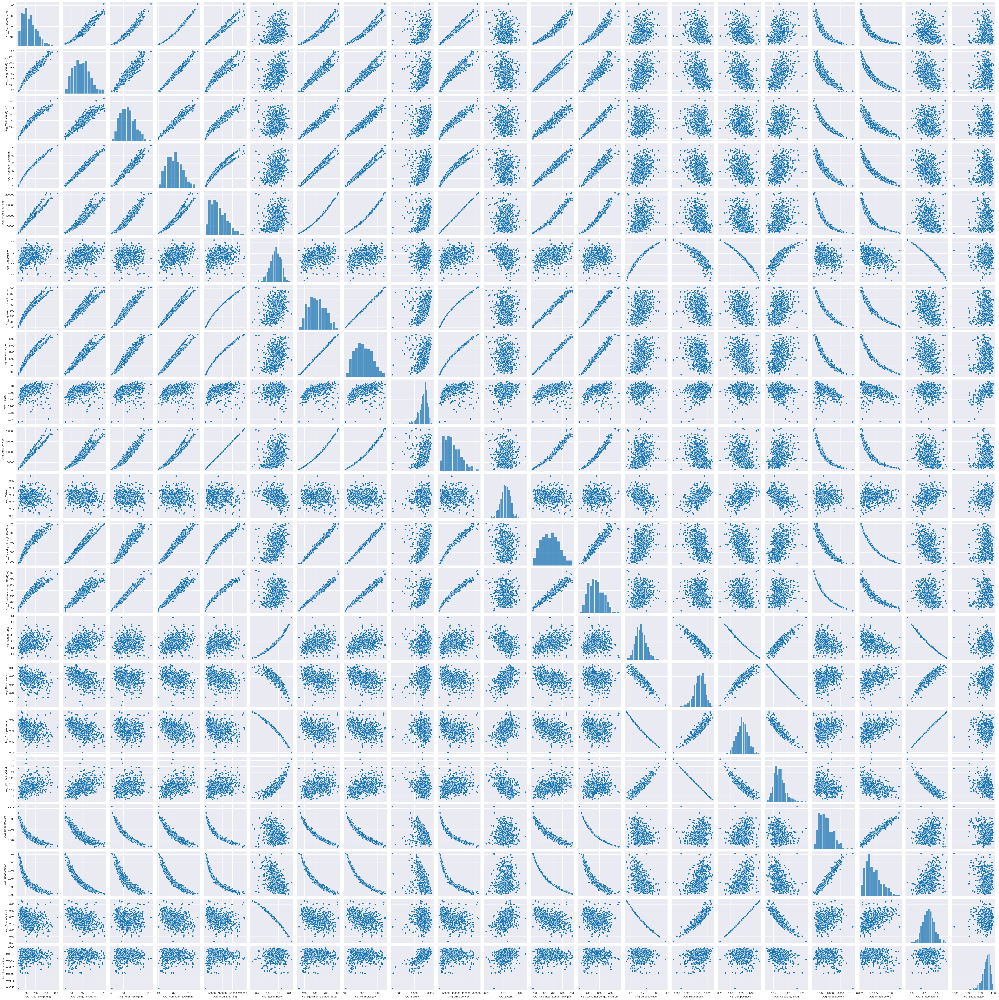

In [14]:
# Exploratory Data Analysis (EDA)
exploratory_data_analysis(avg_df)
check_balance(avg_df)
heatmap(avg_df)
kdplot(avg_df)
extremes_df(avg_df)
pairplot(avg_df)

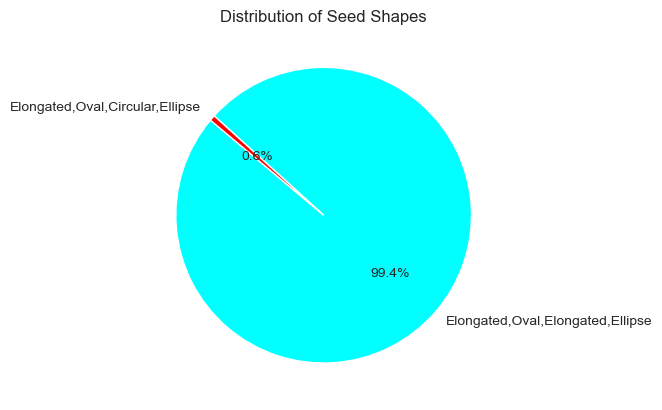

In [15]:
# Calculate the occurrences of each shape
shape_counts = SAM['Shape'].value_counts()

# Plot a pie chart
plt.figure()
plt.pie(shape_counts,
        labels=shape_counts.index,
        autopct='%1.1f%%',
        startangle=140,
        colors=['aqua','red'],
        textprops={'fontsize': 10})
plt.title('Distribution of Seed Shapes', fontsize=12)
plt.show()



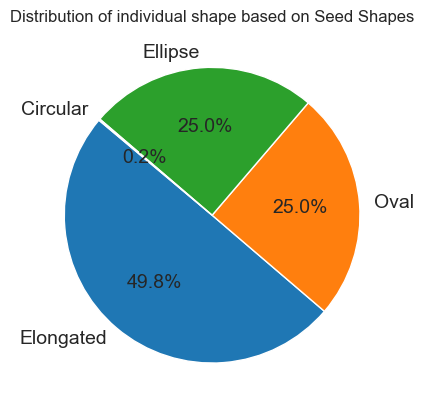

In [16]:
# Split comma-separated values and flatten the list
all_shapes = SAM['Shape'].str.split(',').explode()

# Count the occurrences of each unique shape descriptor
shape_counts = all_shapes.value_counts()

# Plot a pie chart
plt.figure()
plt.pie(shape_counts, labels=shape_counts.index, autopct='%1.1f%%', startangle=140,textprops={'fontsize': 14})
plt.title('Distribution of individual shape based on Seed Shapes')
plt.show()


The pie chart illustrates the proportional distribution of various shapes within the seeds. The largest portion of the pie chart is occupied by seeds which are elongated in shape, indicating it is the most dominant group, accounting for approximately (99.4%) of the total. This is followed by oval and ellips seeds which constitutes around 25% each, the remaining seeds are circular in shape, and it contributes to comparatively smaller proportions (0.2%).

In [17]:
col=SAM[['ID', 'RGB value of Seed','color_seeds']]

### Colour of seeds and RGB value

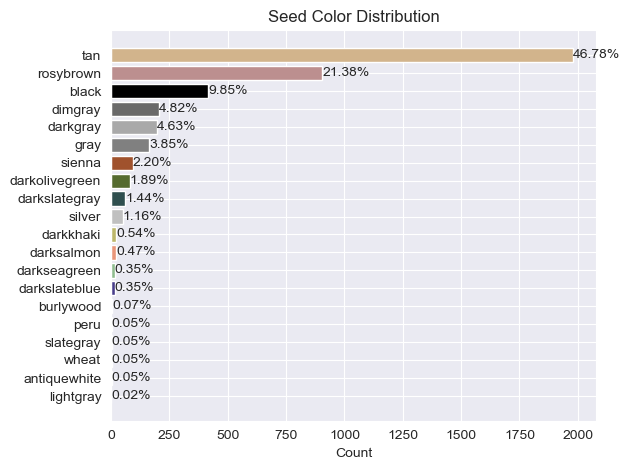

In [18]:
# Pyramid chart with percentage annotations
col_counts = col['color_seeds'].value_counts()
sorted_col_counts = col_counts.sort_values()
total = sorted_col_counts.sum()

plt.figure()
bars = plt.barh(
    sorted_col_counts.index,
    sorted_col_counts.values,
    color=sorted_col_counts.index.map(lambda x: x.lower())
)

# Add percentage annotations
for bar, count in zip(bars, sorted_col_counts.values):
    percent = (count / total) * 100
    plt.text(
        count + 0.5,                        
        bar.get_y() + bar.get_height() / 2,
        f'{percent:.2f}%',                 
        va='center'
    )

plt.xlabel('Count')
plt.title('Seed Color Distribution', fontsize=12)
plt.tight_layout()
plt.show()


### Result for EDA on average seed data analysis
The dataset comprises 554 entries, each representing a unique seed class identified by specific codes, such as Vf1-1-2, Vf497-1-1, and Vf99-4-1, among others. These classes correspond to distinct varieties of seeds, likely categorized based on genetic lineage or specific breeding programs. Each class has been meticulously measured for various morphological features, providing a detailed overview of seed size and shape.

For instance, the class Vf90-1-1 consistently appears as the class with the smallest values for several features, including area (21.91 mm²), length (5.64 mm), width (4.95 mm), and perimeter (16.57 mm). This indicates that seeds in this class are generally smaller and more compact compared to others. On the other hand, class Vf342-3-1 has the largest seed area (457.54 mm²), suggesting that seeds in this class are significantly larger.

Similarly, class Vf413-3-1 has the longest seeds (28.26 mm) and the largest perimeter (76.97 mm), indicating elongated and possibly irregular shapes. Class Vf46-1-1 shows the widest seeds (23.36 mm), while class Vf589-3-1 and Vf243-1-1 exhibit the most variation in eccentricity and aspect ratio, respectively, suggesting differences in how elongated or circular the seeds are.

Other classes, such as Vf260-1-1, show the highest values for equivalent diameter (589.50), convex area (274,837), and perimeter (2010.33), indicating seeds with larger and more irregular shapes. Class Vf603-1-1 has the highest circularity (1.40), suggesting seeds that are closer to a perfect circle.

Correlation analysis:
This indicates that as one of these variables increases, the others also tend to increase. For example, seeds with larger areas are likely to have greater lengths, widths, and perimeters, as well as larger equivalent diameters and convex areas. These positive correlations suggest that these morphological features are interrelated and tend to scale together.
Strong negative correlation was observed between circularity and roundness, indicating that as the circularity of the seeds increases, their roundness decreases, suggesting more elongated or irregular shapes. Similarly, the strong negative correlation between aspect ratio and compactness implies that seeds with a higher aspect ratio (more elongated) tend to have lower compactness values, indicating less dense and solid shapes. Additionally, the negative correlation between eccentricity and compactness suggests that more elongated seeds have lower compactness values. Lastly, the correlation between aspect ratio and eccentricity indicates that as the aspect ratio increases, the eccentricity decreases, suggesting a more uniform elongation. 

The kernel density plots provided valuable insights into the distribution and skewness of numerical features in the dataset. These visualizations helped identify patterns, anomalies, and the overall structure of the data, which were crucial for further analysis and modeling.

The pairplot analysis provided valuable insights into the relationships and distributions of numerical features within the dataset. The scatter plots revealed various patterns and trends, including clusters and correlations between features. Strong positive correlations were observed between certain pairs of features similar to the results of correlation anlaysis, indicating a close relationship. The histograms on the diagonal plots illustrated the distribution of each feature, highlighting differences in spread and skewness.

In conclusion, the dataset reveals significant variability in both the size and shape of seeds across different classes. Each class exhibits distinct physical characteristics, influenced by genetic factors and environmental conditions. Understanding these differences is crucial for selecting seed varieties for specific agricultural purposes, such as optimizing yield, improving resistance to pests, or enhancing nutritional content. The detailed measurements provide valuable insights into the morphological characteristics of seeds, which can inform breeding programs and agricultural practices.



## Results-from both datasets
The analysis of the two datasets reveals interesting insights when comparing individual seed data to the average data for each seed class.

1. Area
For the parameter area, both datasets indicate that the maximum value was observed in class Vf342-3-1. The maximum area for individual seeds is 457.54 mm², while the average area for the class is slightly lower at 413.87 mm². This suggests that while class Vf342-3-1 generally has larger seeds, there is variability within the class. The minimum area is 29.57 mm² in class Vf62-1-1, indicating that this class has the smallest seeds on average.

2. Length
For length, the maximum values differ between the datasets. The maximum length for individual seeds is 28.26 mm in class Vf413-3-1, while the average maximum length for the class is 25.12 mm in class Vf335-3-1. This indicates that class Vf413-3-1 has some of the longest individual seeds, but on average, class Vf335-3-1 has longer seeds. The minimum length is 6.99 mm in class Vf94-1-2, suggesting that this class has the shortest seeds on average.

3. Width
For width, both datasets indicate that the maximum value was observed in class Vf342-3-1. The maximum width for individual seeds is 23.36 mm, while the average maximum width for the class is 21.19 mm. This shows that class Vf342-3-1 generally has wider seeds, but there is variability within the class. The minimum width is 5.28 mm in class Vf62-1-1, indicating that this class has the narrowest seeds on average.

4. Eccentricity
For eccentricity, the maximum value is 0.82 in class Vf547-3-2, while the minimum value is 0.45 in class Vf589-3-1. This suggests that class Vf547-3-2 has more elongated seeds, while class Vf589-3-1 has more circular seeds.

5. Equivalent Diameter Area
For equivalent diameter area, both datasets indicate that the maximum value was observed in class Vf342-3-1. The maximum equivalent diameter area for individual seeds is 589.50, while the average maximum equivalent diameter area for the class is 510.79. This shows that class Vf342-3-1 generally has larger seeds, but there is variability within the class. The minimum equivalent diameter area is 149.44 in class Vf62-1-1, indicating that this class has the smallest seeds on average.

6. Solidity
For solidity, the maximum value is 0.99 in class Vf183-1-2, while the minimum value is 0.98 in class Vf62-1-1. This suggests that class Vf183-1-2 has more solid seeds, while class Vf62-1-1 has less solid seeds.

7. Area Convex
For area convex, the maximum value is 210,862 in class Vf72-1-1, while the minimum value is 17,838 in class Vf62-1-1. This indicates that class Vf72-1-1 has more irregularly shaped seeds, while class Vf62-1-1 has more regularly shaped seeds.

8. Extent
For extent, the maximum value is 0.81 in class Vf578-2-1, while the minimum value is 0.70 in class Vf329-3-1. This suggests that class Vf578-2-1 has seeds that fill their bounding box more completely, while class Vf329-3-1 has seeds that fill their bounding box less completely.

9. Aspect Ratio
For aspect ratio, the maximum value is 1.77 in class Vf547-3-2, while the minimum value is 1.14 in class Vf589-3-1. This indicates that class Vf547-3-2 has more elongated seeds, while class Vf589-3-1 has more circular seeds.

10. Roundness
For roundness, the maximum value is 0.89 in class Vf144-1-1, while the minimum value is 0.79 in class Vf547-3-2. This suggests that class Vf144-1-1 has more circular seeds, while class Vf547-3-2 has less circular seeds.

11. Compactness
For compactness, the maximum value is 0.94 in class Vf589-3-1, while the minimum value is 0.75 in class Vf547-3-2. This indicates that class Vf589-3-1 has more compact seeds, while class Vf547-3-2 has less compact seeds.

12. Circularity
For circularity, the maximum value is 1.26 in class Vf547-3-2, while the minimum value is 1.13 in class Vf144-1-1. This suggests that class Vf547-3-2 has more circular seeds, while class Vf144-1-1 has less circular seeds.

The comparison of the results from the two datasets reveals several key insights into the morphological features of seeds, both at the individual seed level and the average class level.

Strong Positive Correlations
For individual seeds, strong positive correlations (0.9-1) were observed among Area_mm2_SAM, Length_mm_SAM, Width_mm_SAM, perimeter_mm_SAM, Area_pix_SAM, equivalent_diameter_area, perimeter, area_convex, Axis Major Length(pix)_SAM, and Axis Minor Length(pix)_SAM. This indicates that as one of these variables increases, the others also tend to increase. For example, seeds with larger areas are likely to have greater lengths, widths, and perimeters, as well as larger equivalent diameters, convex areas, and axis lengths. These positive correlations suggest that these morphological features are interrelated and tend to scale together, reflecting the overall size and shape of the seeds.

Similarly, for average seed data, strong positive correlations were observed among average area, length, width, perimeter, equivalent diameter area, and area convex. This indicates that as one of these variables increases, the others also tend to increase. For example, seeds with larger areas are likely to have greater lengths, widths, and perimeters, as well as larger equivalent diameters and convex areas. These positive correlations suggest that these morphological features are interrelated and tend to scale together.

Strong Negative Correlations
For individual seeds, strong negative correlations were observed between compactness and eccentricity, indicating that as the compactness of the seeds increases, their eccentricity decreases. Similarly, the strong negative correlation between eccentricity and shapefactor3 implies that seeds with higher eccentricity values tend to have lower shapefactor3 values, indicating that more elongated seeds have less dense shapes. Lastly, the negative correlation between aspect ratio and shapefactor3 suggests that seeds with higher aspect ratios (more elongated) tend to have lower shapefactor3 values, indicating a less dense shape.

For average seed data, strong negative correlations were observed between circularity and roundness, indicating that as the circularity of the seeds increases, their roundness decreases, suggesting more elongated or irregular shapes. Similarly, the strong negative correlation between aspect ratio and compactness implies that seeds with a higher aspect ratio (more elongated) tend to have lower compactness values, indicating less dense and solid shapes. Additionally, the negative correlation between eccentricity and compactness suggests that more elongated seeds have lower compactness values. Lastly, the correlation between aspect ratio and eccentricity indicates that as the aspect ratio increases, the eccentricity decreases, suggesting a more uniform elongation.

In summary, while the specific values differ between individual seed data and average class data, both datasets consistently identify certain classes as having the extreme values for these parameters. This highlights the diversity in seed morphology and the importance of considering both individual and average data for comprehensive analysis. Understanding these differences is crucial for selecting seed varieties for specific agricultural purposes, such as optimizing yield, improving resistance to pests, or enhancing nutritional content.

### Result for EDA on average seed data analysis
The dataset comprises 554 entries, each representing a unique seed class identified by specific codes, such as Vf1-1-2, Vf497-1-1, and Vf99-4-1, among others. These classes correspond to distinct varieties of seeds, likely categorized based on genetic lineage or specific breeding programs. Each class has been meticulously measured for various morphological features, providing a detailed overview of seed size and shape.

For instance, the class Vf90-1-1 consistently appears as the class with the smallest values for several features, including area (21.91 mm²), length (5.64 mm), width (4.95 mm), and perimeter (16.57 mm). This indicates that seeds in this class are generally smaller and more compact compared to others. On the other hand, class Vf342-3-1 has the largest seed area (457.54 mm²), suggesting that seeds in this class are significantly larger.

Similarly, class Vf413-3-1 has the longest seeds (28.26 mm) and the largest perimeter (76.97 mm), indicating elongated and possibly irregular shapes. Class Vf46-1-1 shows the widest seeds (23.36 mm), while class Vf589-3-1 and Vf243-1-1 exhibit the most variation in eccentricity and aspect ratio, respectively, suggesting differences in how elongated or circular the seeds are.

Other classes, such as Vf260-1-1, show the highest values for equivalent diameter (589.50), convex area (274,837), and perimeter (2010.33), indicating seeds with larger and more irregular shapes. Class Vf603-1-1 has the highest circularity (1.40), suggesting seeds that are closer to a perfect circle.

Correlation analysis:
This indicates that as one of these variables increases, the others also tend to increase. For example, seeds with larger areas are likely to have greater lengths, widths, and perimeters, as well as larger equivalent diameters and convex areas. These positive correlations suggest that these morphological features are interrelated and tend to scale together.
Strong negative correlation was observed between circularity and roundness, indicating that as the circularity of the seeds increases, their roundness decreases, suggesting more elongated or irregular shapes. Similarly, the strong negative correlation between aspect ratio and compactness implies that seeds with a higher aspect ratio (more elongated) tend to have lower compactness values, indicating less dense and solid shapes. Additionally, the negative correlation between eccentricity and compactness suggests that more elongated seeds have lower compactness values. Lastly, the correlation between aspect ratio and eccentricity indicates that as the aspect ratio increases, the eccentricity decreases, suggesting a more uniform elongation. 

The kernel density plots provided valuable insights into the distribution and skewness of numerical features in the dataset. These visualizations helped identify patterns, anomalies, and the overall structure of the data, which were crucial for further analysis and modeling.

The pairplot analysis provided valuable insights into the relationships and distributions of numerical features within the dataset. The scatter plots revealed various patterns and trends, including clusters and correlations between features. Strong positive correlations were observed between certain pairs of features similar to the results of correlation anlaysis, indicating a close relationship. The histograms on the diagonal plots illustrated the distribution of each feature, highlighting differences in spread and skewness.

In conclusion, the dataset reveals significant variability in both the size and shape of seeds across different classes. Each class exhibits distinct physical characteristics, influenced by genetic factors and environmental conditions. Understanding these differences is crucial for selecting seed varieties for specific agricultural purposes, such as optimizing yield, improving resistance to pests, or enhancing nutritional content. The detailed measurements provide valuable insights into the morphological characteristics of seeds, which can inform breeding programs and agricultural practices.

